In [1]:
from metadata import Metadata
import matplotlib.pyplot as plt
import pickle
img_path = '/hybedata/Images/Zach/ExVivo/15Hr_2019May10/'
md = Metadata(img_path)
from fish_helpers import *
from segmentation_3D import *
import matplotlib.pyplot as plt
from skimage.external import tifffile

In [193]:
spotcalls = pickle.load(open(os.path.join(img_path,'results/wounded_spotcalls.pkl'),'rb'))

In [3]:
spotcalls

,gene,ssum,centroid,ave,npixels,cword_idx,z,posname,CoordX,CoordY
0,Il6ra,3247.0,"(4.0, 136.0)",811.750000,1,70,5,Pos132,-3404.408000,2568.436000
1,Gja1,19033.0,"(6.2, 1524.6)",951.650000,5,59,5,Pos132,-3253.050600,2568.675800
2,Pak1,18634.0,"(7.333333333333333, 340.3333333333333)",1552.833333,3,111,5,Pos132,-3382.135667,2568.799333
3,Itga6,9766.0,"(9.5, 1531.0)",1220.750000,2,75,5,Pos132,-3252.353000,2569.035500
4,Bcl6,9771.0,"(10.5, 1529.0)",1221.375000,2,18,5,Pos132,-3252.571000,2569.144500
5,Il6ra,14626.0,"(15.666666666666666, 453.3333333333333)",1218.833333,3,70,5,Pos132,-3369.818667,2569.707667
6,Fzd7,22578.0,"(18.6, 960.2)",1128.900000,5,57,5,Pos132,-3314.570200,2570.027400
7,Gja1,10717.0,"(19.0, 1325.5)",1339.625000,2,59,5,Pos132,-3274.752500,2570.071000
8,Vps35,11005.0,"(21.5, 675.0)",1375.625000,2,169,5,Pos132,-3345.657000,2570.343500
9,Gja1,11083.0,"(21.333333333333332, 1781.6666666666667)",923.583333,3,59,5,Pos132,-3225.030333,2570.325333


<IPython.core.display.Javascript object>


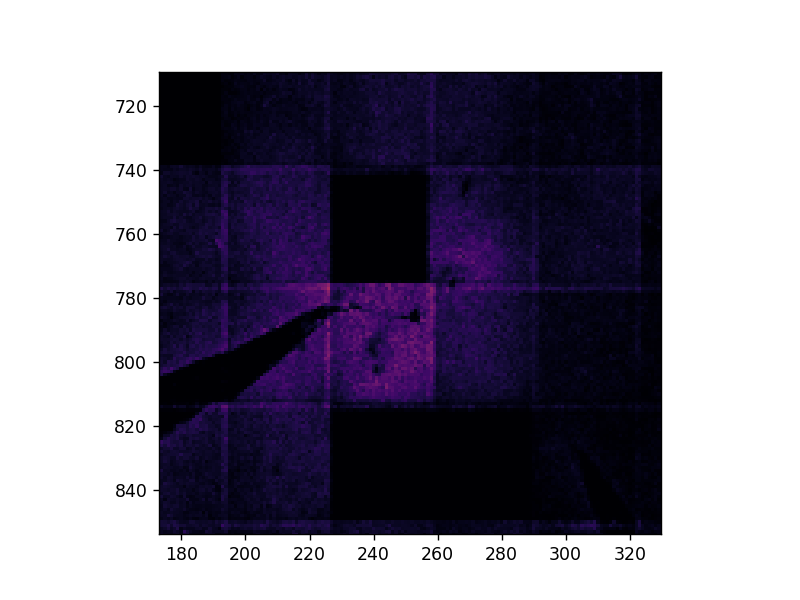

In [17]:
%matplotlib notebook
xy = np.histogram2d(spotcalls.CoordX,spotcalls.CoordY,bins=1000)
plt.imshow(xy[0],cmap='inferno')
plt.show()

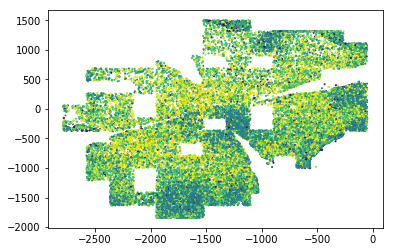

In [194]:
%matplotlib inline
temp_spotcalls = spotcalls[(spotcalls.ave>np.percentile(spotcalls.ave,99))]
plt.scatter(temp_spotcalls.CoordX,temp_spotcalls.CoordY,c=temp_spotcalls.cword_idx,s=1)
plt.show()

['Pos220']


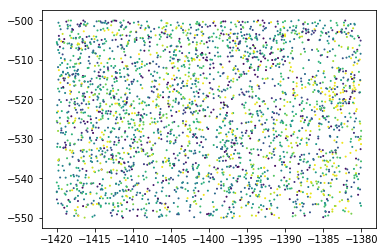

In [199]:
%matplotlib inline
temp_spotcalls = spotcalls[(spotcalls.CoordX<-1380)&(spotcalls.CoordX>-1420)&(spotcalls.CoordY<-500)&(spotcalls.CoordY>-550)]
print(temp_spotcalls.posname.unique())
plt.scatter(temp_spotcalls.CoordX,temp_spotcalls.CoordY,c=temp_spotcalls.cword_idx,s=1)
plt.show()

opening img_Pos220_000000020_000000000_DeepBlue_000_020.tif

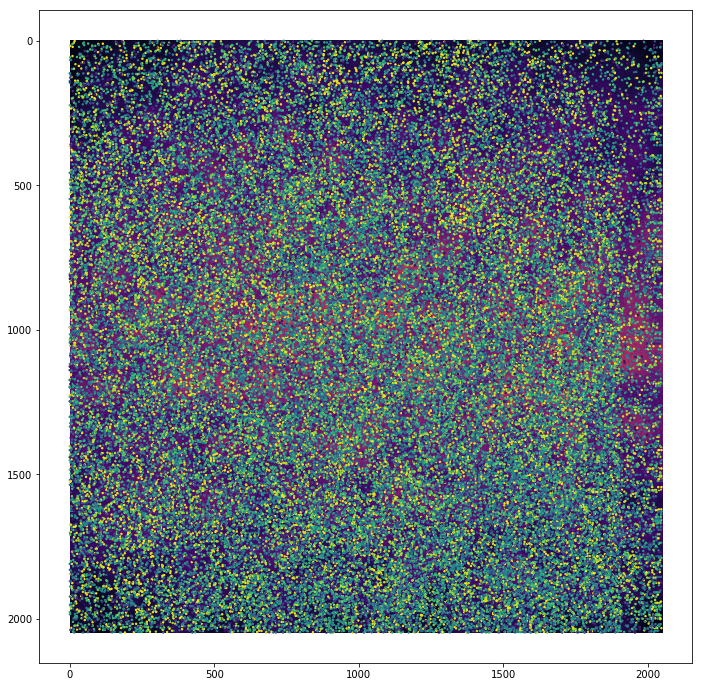

In [200]:
plt.figure(figsize=(12,12))
pos = 'Pos220'
acq = [i for i in md.image_table.acq.unique() if 'nucstain' in i]
plt.imshow(md.stkread(Position=pos,acq=acq,Zindex=display_z)[:,:,0],cmap='inferno')
xy = np.stack(spotcalls[spotcalls.posname==pos].centroid,axis=0)
plt.scatter(xy[:,1],xy[:,0],c=spotcalls[spotcalls.posname==pos].cword_idx,s=2)
plt.show()

In [3]:
pos = 'Pos1'
pos_path = os.path.join(img_path,'results',pos)
if not os.path.exists(pos_path):
    os.makedirs(pos_path)
    print('making dir')
params = {
    'image_blur' : 4.0, #gaussian kernal
    'threshold' : 65, #0-100
    'smallest_object' : 900, #pixels
    'dist_intensity_ratio' : 0.75, #0-1 weight
    'separation_distance' : 50, #pixels
    'edge_filter_blur' : 4.0, #kernel width in pixels
    'watershed_ratio' : 0.9, #0-1 ratio of distance from edge vs bwgeodesic
    'remove_image_edges': 0, # If true set all edges to 0
    'wavelet': 'db9', # wavelet to use
    'keep_list': [4,5,6], # wavelets to keep
                 }
display_z = 20
with open(os.path.join(pos_path,'params.txt'), "w") as text_file:
    text_file.write(str(params))

In [4]:
#Recover
%matplotlib inline
from skimage import io
pos = 'Pos1'
pos_path = os.path.join(img_path,'results',pos)
params = {
    'image_blur' : 4.0, #gaussian kernal
    'threshold' : 65, #0-100
    'smallest_object' : 900, #pixels
    'dist_intensity_ratio' : 0.75, #0-1 weight
    'separation_distance' : 50, #pixels
    'edge_filter_blur' : 4.0, #kernel width in pixels
    'watershed_ratio' : 0.9, #0-1 ratio of distance from edge vs bwgeodesic
    'remove_image_edges': 0, # If true set all edges to 0
    'wavelet': 'db9', # wavelet to use
    'keep_list': [4,5,6], # wavelets to keep
                 }
nucstk = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'nucstk.tiff')),2,1),2,0)
wave_edge = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'wave_edge.tiff')),2,1),2,0)
wave_cell = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'wave_cell.tiff')),2,1),2,0)
wave_sum = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'wave_sum.tiff')),2,1),2,0)
blurred = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'blurred.tiff')),2,1),2,0)
cell_center = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'cell_centers.tiff')),2,1),2,0)
d_mat = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'d_mat.tiff')),2,1),2,0)
markers = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'markers.tiff')),2,1),2,0)
im_edge = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'im_edge.tiff')),2,1),2,0)
im_bin = binarize(blurred,params['threshold'],params['smallest_object'])
watershed = np.swapaxes(np.swapaxes(io.imread(os.path.join(pos_path,'watershed.tiff')),2,1),2,0)


In [207]:
display_z = 40

opening img_Pos220_000000040_000000000_DeepBlue_000_040.tif

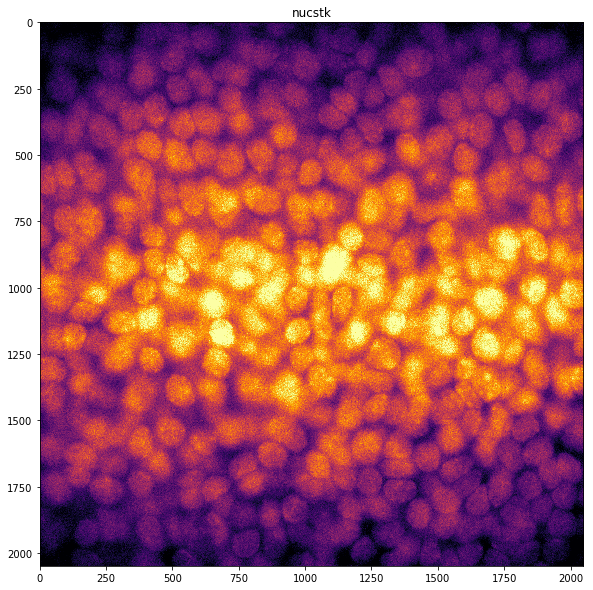

In [206]:
acq = [i for i in md.image_table.acq.unique() if 'nucstain' in i]
pos = 'Pos220'
nucimg = md.stkread(Position=pos,Channel='DeepBlue',acq=acq,Zindex=display_z)[:,:,0]
Display(nucimg,title='nucstk')

opening img_Pos1_000000066_000000000_DeepBlue_000_066.tif

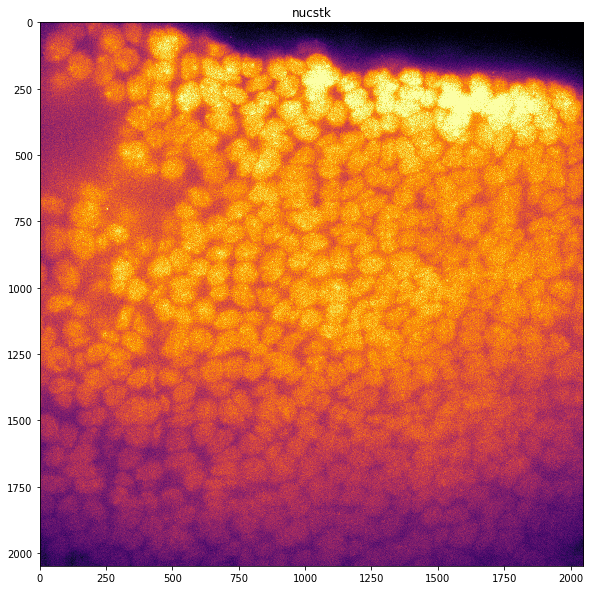

In [17]:
acq = [i for i in md.image_table.acq.unique() if 'nucstain' in i]
nucstk = md.stkread(Position=pos,Channel='DeepBlue',acq=acq)
fname = os.path.join(pos_path,'nucstk.tiff')
tifffile.imsave(fname, np.swapaxes(np.swapaxes(nucstk,0,2),1,2), metadata={'axes': 'ZYX'})
Display(nucstk[:,:,display_z],title='nucstk')

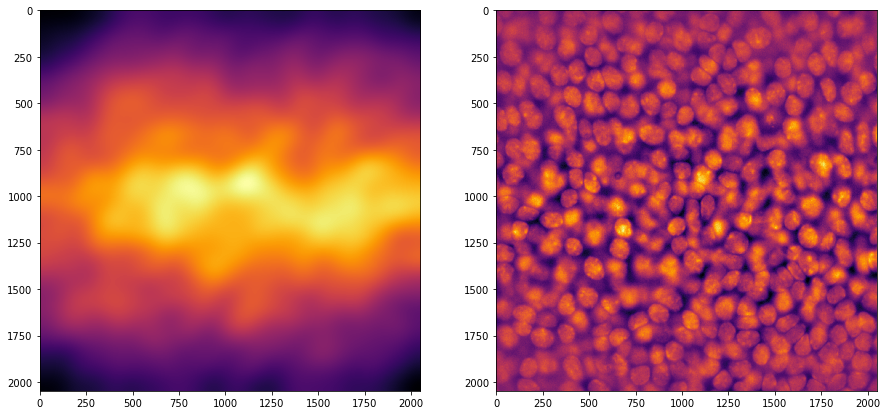

In [208]:
# nucimg = np.swapaxes(nucstk[:,:,display_z],0,1)
bkg = filters.threshold_local(nucimg,401)
# opened = morphology.opening(nucimg-bkg)
# closed = morphology.closing(opened)
# for i in range(25):
#     opened = morphology.opening(closed)
#     closed = morphology.closing(opened)
# bkg_sub = closed

bkg_sub = filters.threshold_local(nucimg-bkg,11)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(bkg,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

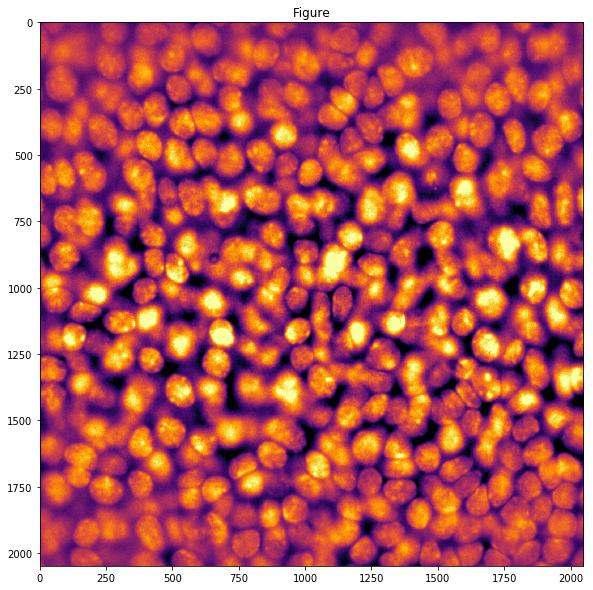

In [209]:
Display(bkg_sub,cmap='inferno')

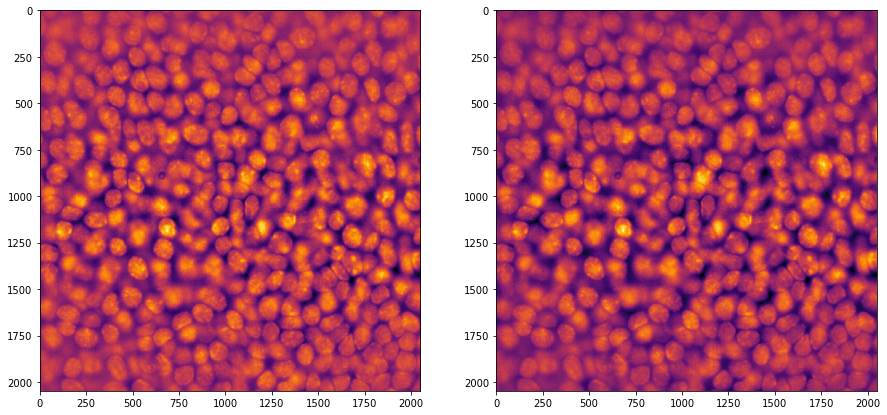

In [210]:
wave_cell = wavelettransform(bkg_sub,'db3',keep_list=[3,4,5,6,7,8])
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(wave_cell,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

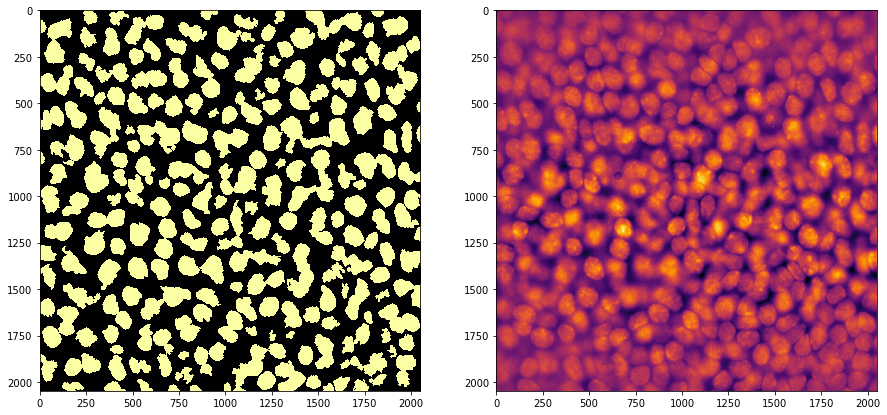

In [211]:
def binarize(stk,thresh,min_size):
    im_bin = np.zeros_like(stk)
    im_bin = im_bin!=0
    if stk.ndim==3:
        for z in range(stk.shape[2]):
            img = filters.gaussian(stk[:,:,z].copy(),1)
            binary = img>np.percentile(img.ravel(),thresh)
            binary = morphology.remove_small_objects(binary,50)
            binary = morphology.remove_small_holes(binary, min_size)
            binary = morphology.remove_small_objects(binary, min_size)
            dilated = morphology.binary_dilation(binary)
            for i in range(8):
                dilated = morphology.binary_erosion(dilated)
                dilated = morphology.binary_dilation(dilated)
            dilated = morphology.binary_dilation(dilated)
            im_bin[:,:,z] = dilated
    elif stk.ndim==2:
        img = filters.gaussian(stk.copy(),1)
        binary = img>np.percentile(img.ravel(),thresh)
        binary = morphology.remove_small_objects(binary,50)
        binary = morphology.remove_small_holes(binary, min_size)
        binary = morphology.remove_small_objects(binary, min_size)
        dilated = morphology.binary_dilation(binary)
        for i in range(8):
            dilated = morphology.binary_erosion(dilated)
            dilated = morphology.binary_dilation(dilated)
        dilated = morphology.binary_dilation(dilated)
        im_bin = dilated
    return im_bin
blurred_z = filters.threshold_local(wave_cell,11)
im_bin = binarize(blurred_z,60,1000)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_bin,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

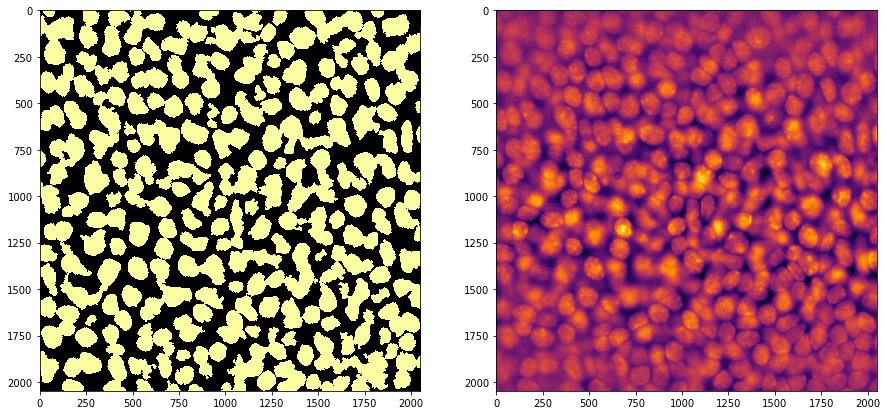

In [212]:
thresh = 50
min_size = 1500
img = wave_cell.copy()
for i in range(10):
    img = morphology.opening(img)
    img = morphology.closing(img)
binary = img>np.percentile(img.ravel(),thresh)
binary = morphology.remove_small_objects(binary,50)
binary = morphology.remove_small_holes(binary, min_size)
binary = morphology.remove_small_objects(binary, min_size)
binary = ndimage.binary_dilation(binary,iterations=2)
for i in range(3):
    binary = ndimage.binary_opening(binary)
    binary = ndimage.binary_closing(binary)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(binary,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

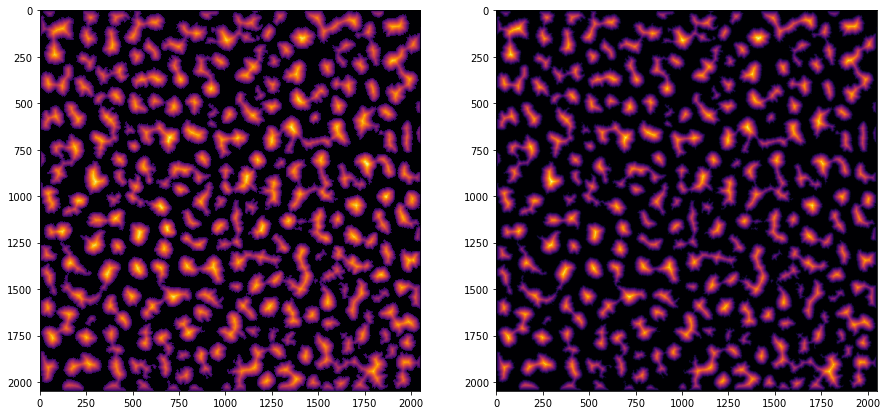

In [213]:
im_cent, d_mat = cell_centers(wave_cell, binary, 0.75)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_cent,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(d_mat,cmap='inferno')

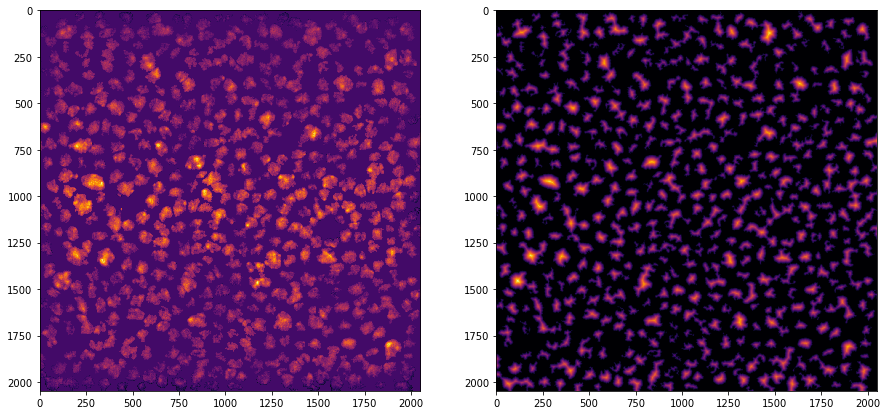

In [120]:
im_cent, d_mat = cell_centers(bkg_sub, im_bin, 0.75)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_cent,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(d_mat,cmap='inferno')

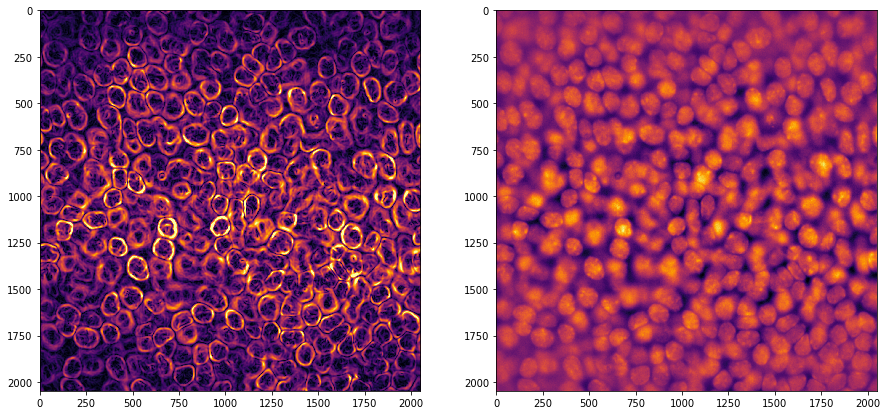

In [214]:
def sobel_edges(stk, val):
    temp = np.zeros_like(stk)
    if val != 0:
        if val <= 5:
            stk = filters.gaussian(stk, val)
        else:
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
    temp = np.zeros_like(stk)
    if stk.ndim==2:
        im = filters.sobel(stk) + 1
        temp = im
    elif stk.ndim==3:
        for z in range(stk.shape[2]):
            im = stk[:,:,z]
            im = filters.sobel(im) + 1
            temp[:,:,z]=im
    temp_min = np.percentile(temp.ravel(),0)
    temp[temp<temp_min] = temp_min
    temp = temp-temp_min
    temp_max = np.percentile(temp.ravel(),99.5)
    temp[temp>temp_max]=temp_max
    temp = temp/temp_max
    return temp
im_edge = sobel_edges(bkg_sub, params['edge_filter_blur'])
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_edge,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

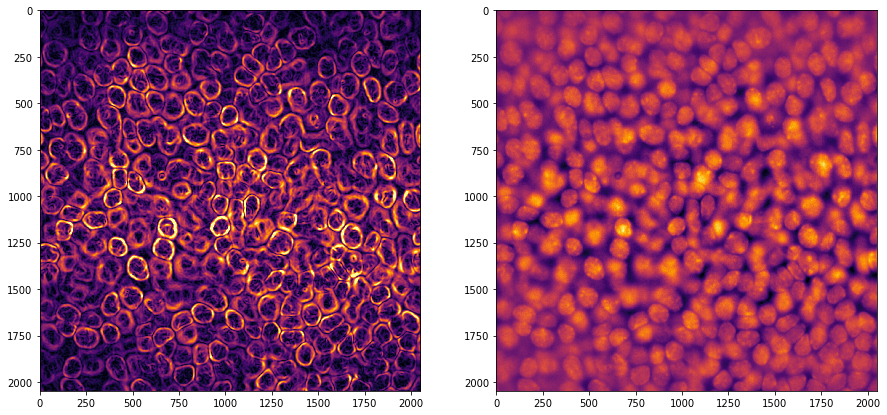

In [215]:
im_edge = sobel_edges(wave_cell, params['edge_filter_blur'])
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_edge,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')

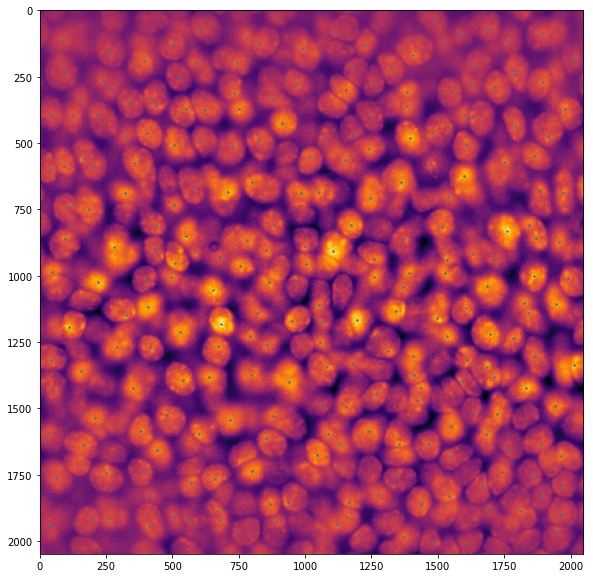

In [216]:
%matplotlib inline
plt.figure(figsize=(10,10))
blurred_z = filters.threshold_local(bkg_sub,81)
xy = peak_local_max(blurred_z,min_distance=10,threshold_rel=0.1)
plt.imshow(bkg_sub,cmap='inferno')
plt.scatter(xy[:,1],xy[:,0],s=2)
plt.show()

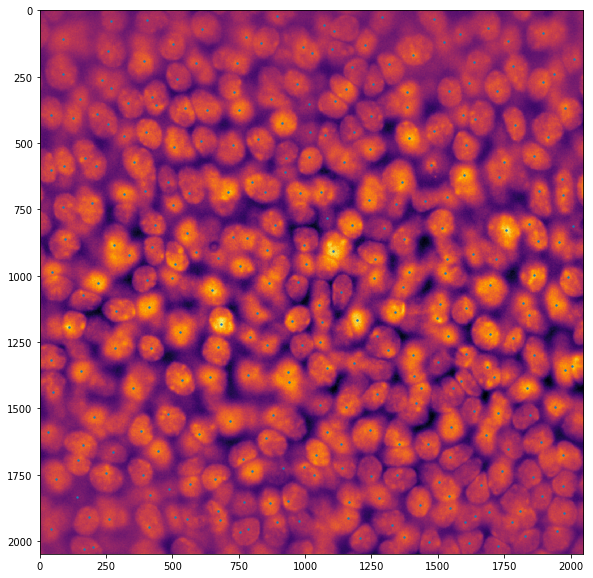

In [217]:
%matplotlib inline
plt.figure(figsize=(10,10))
blurred_z = filters.threshold_local(wave_cell,81)
xy = peak_local_max(blurred_z,min_distance=10,threshold_rel=0.1)
plt.imshow(bkg_sub,cmap='inferno')
plt.scatter(xy[:,1],xy[:,0],s=2)
plt.show()

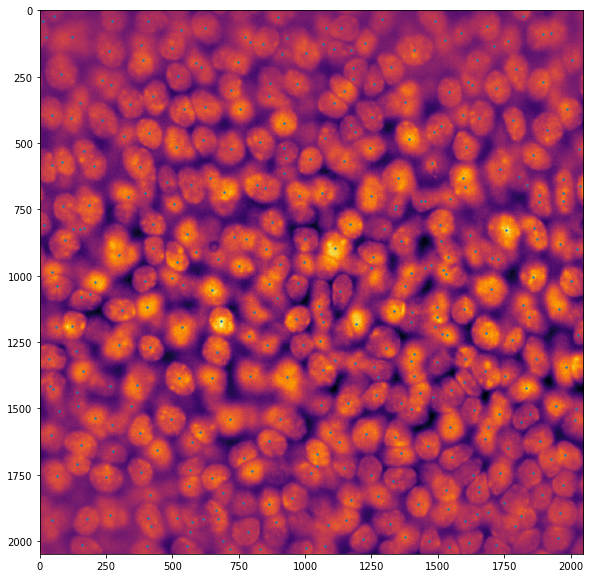

In [218]:
%matplotlib inline
plt.figure(figsize=(10,10))
blurred_z = filters.threshold_local(d_mat,11)
xy = peak_local_max(blurred_z,min_distance=10,threshold_rel=0.1)
plt.imshow(bkg_sub,cmap='inferno')
plt.scatter(xy[:,1],xy[:,0],s=2)
plt.show()

/home/zach/PythonRepos/PyImages/segmentation_3D.py:337: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rgb_img[list(regions[i].coords.T)] = colors[i]  # won't use the 1st color


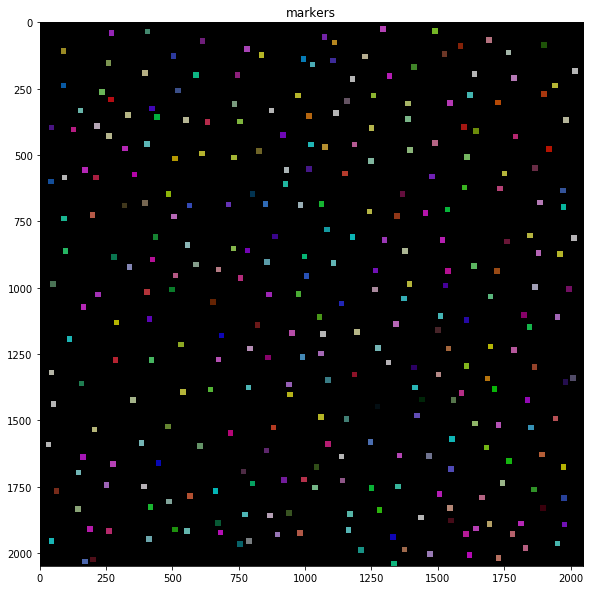

In [219]:
blurred_z = filters.threshold_local(wave_cell,81)
local_maxi = peak_local_max(blurred_z, indices=False, min_distance=int(10), exclude_border=int(1),threshold_rel=0.1)
struct = ndimage.generate_binary_structure(2,2)
local_maxi = ndimage.binary_dilation(local_maxi,structure=struct,iterations=10)
structure = ndimage.morphology.generate_binary_structure(2,1)
markers = ndimage.label(local_maxi,structure=structure)[0]
markers[local_maxi] += 1
out = colorize_segmented_image(markers,color_type='rgb')
Display(out,title='markers',rel_min=0,rel_max=100)

/home/zach/PythonRepos/PyImages/segmentation_3D.py:337: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rgb_img[list(regions[i].coords.T)] = colors[i]  # won't use the 1st color


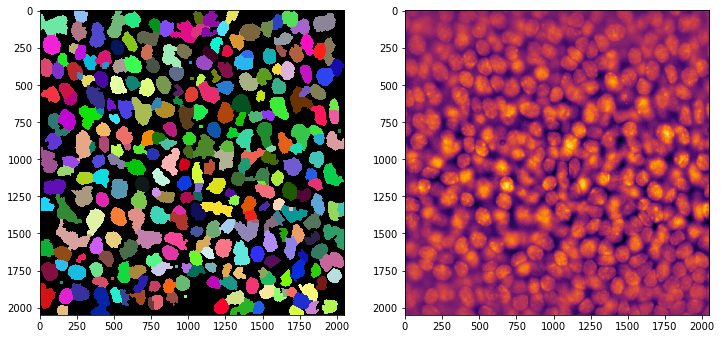

In [226]:
val = 0.6
struct = ndimage.generate_binary_structure(2,2)
im_bin_temp = ndimage.binary_dilation(binary,structure=struct,iterations=5)
markers_temp = markers + np.logical_not(im_bin_temp)
shed_im = (1 - val) * im_edge - val * d_mat
labels = morphology.watershed(image=shed_im, markers=markers_temp)
labels -= 1
edges = 1
if edges == 1:
    edge_vec = np.hstack((labels[:, 0].flatten(), labels[:, -1].flatten(), labels[0, :].flatten(),labels[-1, :].flatten()))
    edge_val = np.unique(edge_vec)
    for val in edge_val:
        if not val == 0:
            labels[labels == val] = 0
plt.figure(figsize=(12,12))
plt.subplot(1, 2, 1)
out = colorize_segmented_image(labels,color_type='rgb')
plt.imshow(out)
plt.subplot(1, 2, 2)
plt.imshow(bkg_sub,cmap='inferno')
plt.show()

In [232]:
pos = 'Pos220'
pos_spotcalls = spotcalls[(spotcalls.posname==pos)&(spotcalls.z>display_z-20)&(spotcalls.z<display_z+20)]


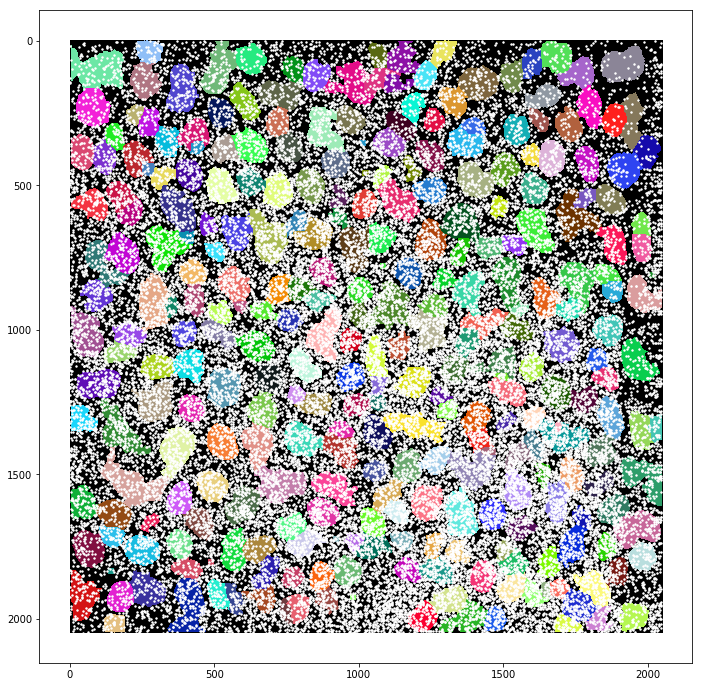

In [233]:
plt.figure(figsize=(12,12))
plt.imshow(out)
xy = np.stack(pos_spotcalls.centroid,axis=0)
plt.scatter(xy[:,1],xy[:,0],c='w',s=2)
plt.show()

opening img_Pos1_000000040_000000000_DeepBlue_000_040.tif

ValueError: need at least one array to stack

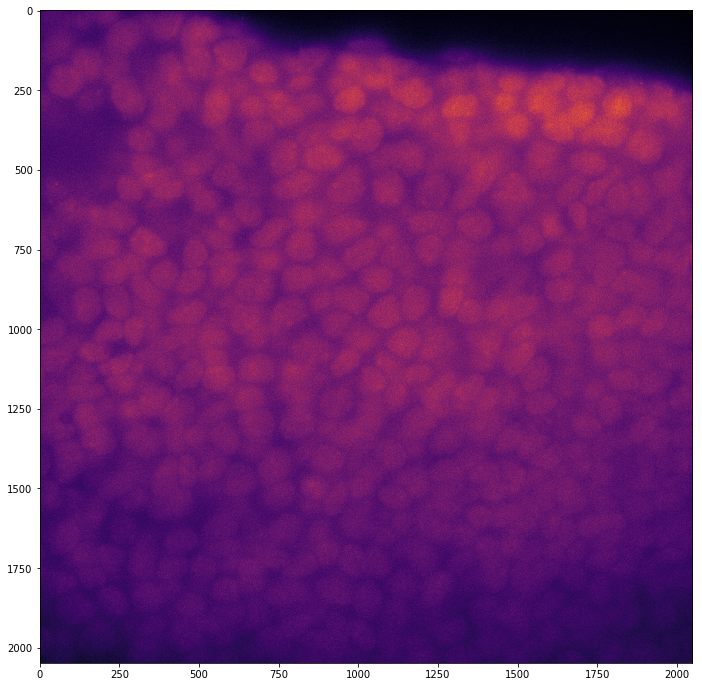

In [228]:
plt.figure(figsize=(12,12))
pos = 'Pos1'
plt.imshow(md.stkread(Position=pos,acq=acq,Zindex=display_z)[:,:,0],cmap='inferno')
xy = np.stack(spotcalls[spotcalls.posname==pos].centroid,axis=0)
plt.scatter(xy[:,1],xy[:,0],c=spotcalls[spotcalls.posname==pos].cword_idx,s=2)
plt.show()

In [161]:
md_path_2Hr = '/hybedata/Images/Zach/ExVivo/2Hr_2019Jun02/'
md_2 = Metadata(md_path_2Hr)
spotcalls_2 = pickle.load(open(os.path.join(md_path_2Hr,'results','wounded_spotcalls.pkl'),'rb'))

In [162]:
print(np.mean(spotcalls_2.CoordX))
print(np.mean(spotcalls_2.CoordY))

583.6838273922249
3665.209688275141


In [180]:
wound_center_spotcalls = spotcalls_2[(spotcalls_2.CoordX<1100)&(spotcalls_2.CoordX>975)&(spotcalls_2.CoordY>3600)&(spotcalls_2.CoordY<3800)]
wound_center_spotcalls.posname.unique()

array(['Pos272', 'Pos273'], dtype=object)

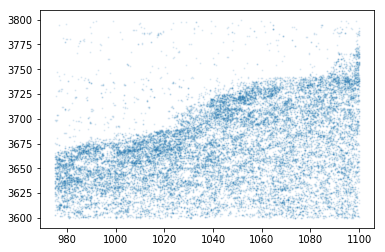

In [181]:
plt.scatter(wound_center_spotcalls.CoordX,wound_center_spotcalls.CoordY,s=1,alpha=0.1)
plt.show()

opening img_Pos272_000000020_000000000_DeepBlue_000_020.tif

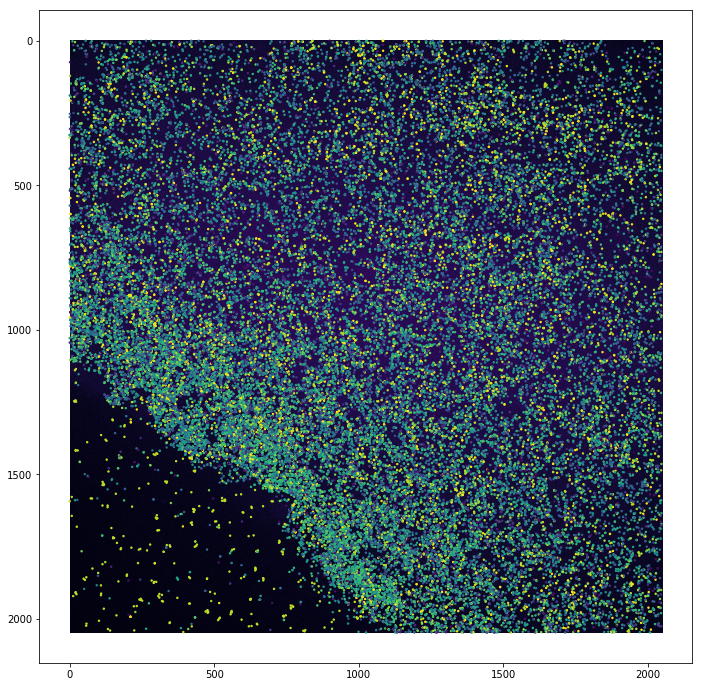

In [182]:

plt.figure(figsize=(12,12))
pos = 'Pos272'
acq = [i for i in md_2.image_table.acq.unique() if 'nucstain' in i][0]
plt.imshow(md_2.stkread(Position=pos,acq=acq,Zindex=display_z)[:,:,0],cmap='inferno')
xy = np.stack(spotcalls_2[spotcalls_2.posname==pos].centroid,axis=0)
plt.scatter(xy[:,1],xy[:,0],c=spotcalls_2[spotcalls_2.posname==pos].cword_idx,s=2)
plt.show()

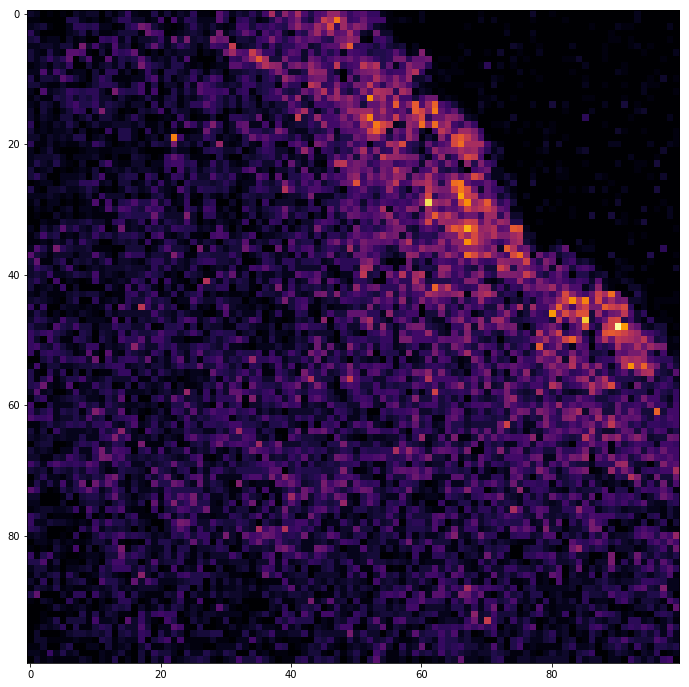

In [185]:
xy = np.histogram2d(spotcalls_2[spotcalls_2.posname==pos].CoordX,spotcalls_2[spotcalls_2.posname==pos].CoordY,bins=100)
plt.figure(figsize=(12,12))
plt.imshow(xy[0],cmap='inferno')
plt.show()

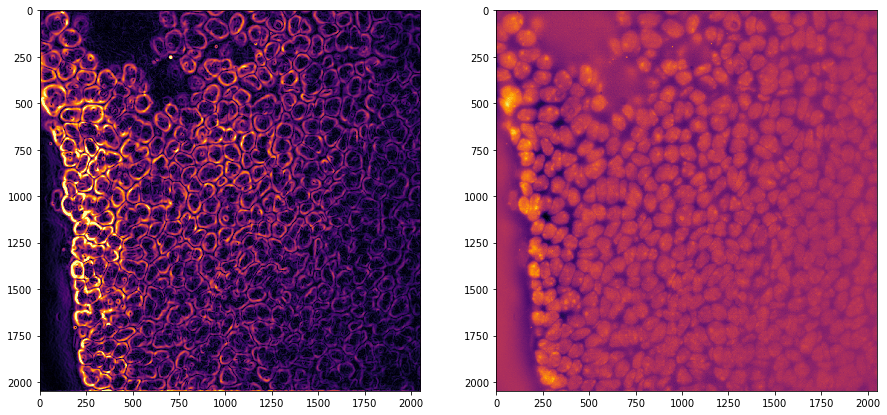

In [36]:
def sobel_edges(stk, val):
    temp = np.zeros_like(stk)
    if val != 0:
        if val <= 5:
            stk = filters.gaussian(stk, val)
        else:
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
    temp = np.zeros_like(stk)
    if stk.ndim==2:
        im = filters.sobel(stk) + 1
        temp = im
    elif stk.ndim==3:
        for z in range(stk.shape[2]):
            im = stk[:,:,z]
            im = filters.sobel(im) + 1
            temp[:,:,z]=im
    temp_min = np.percentile(temp.ravel(),0)
    temp[temp<temp_min] = temp_min
    temp = temp-temp_min
    temp_max = np.percentile(temp.ravel(),99.5)
    temp[temp>temp_max]=temp_max
    temp = temp/temp_max
    return temp
im_edge = sobel_edges(wave_cell[:,:,display_z], params['edge_filter_blur'])
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_edge,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(wave_cell[:,:,display_z],cmap='inferno')

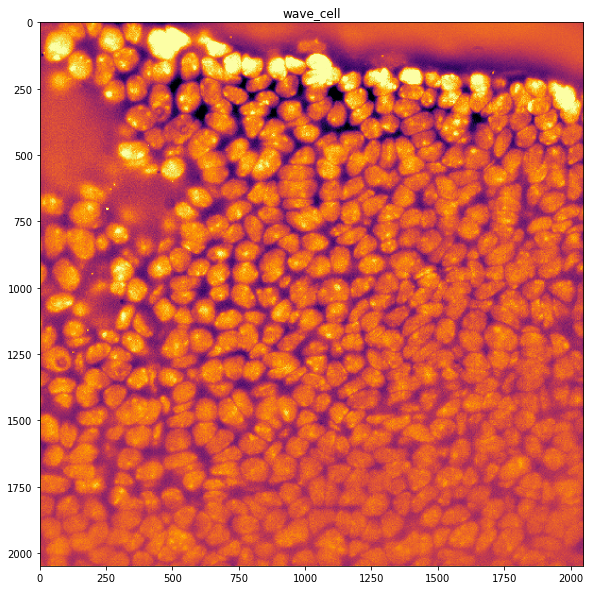

In [276]:
wave_cell = wavelettransform(nucstk,'db3',keep_list=[3,4,5,6,7,8])
fname = os.path.join(pos_path,'wave_cell.tiff')
tifffile.imsave(fname, np.swapaxes(wave_cell,0,2), metadata={'axes': 'ZYX'})
Display(wave_cell[:,:,display_z],title='wave_cell')

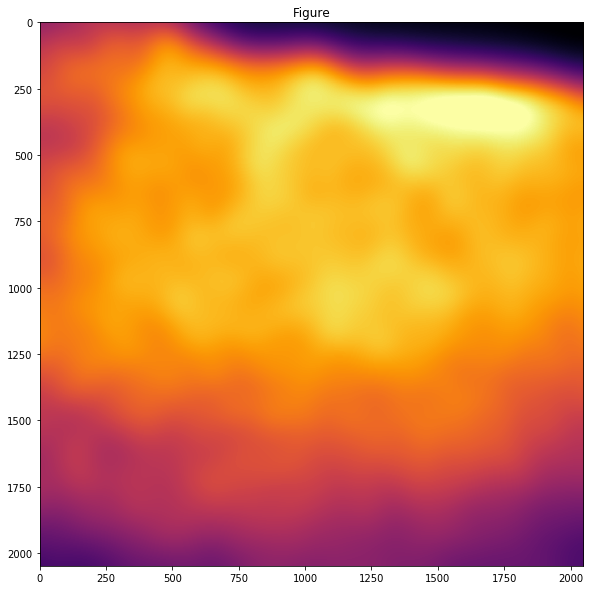

288.4001684188843


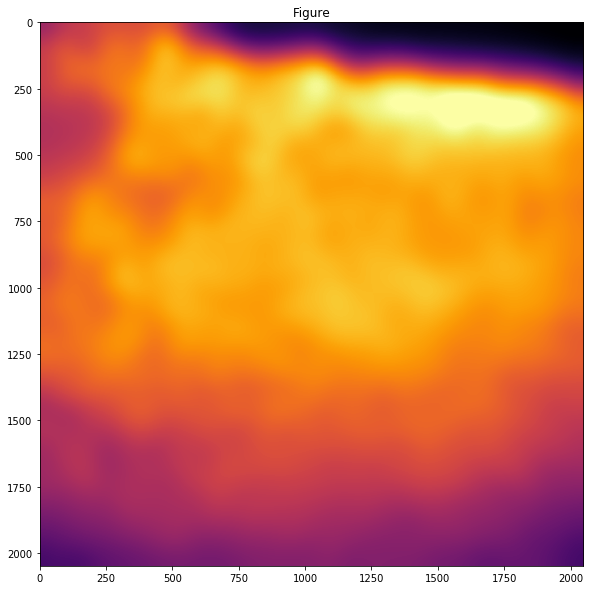

186.26842498779297


In [275]:
import time
tic = time.time()
stk = filters.gaussian(nucstk,50)
Display(stk[:,:,display_z])
print(time.time()-tic)
tic = time.time()
stk = np.zeros_like(nucstk)
for z in range(stk.shape[2]):
            img = nucstk[:,:,z]
            stk[:,:,z] = filters.threshold_local(img,301)
Display(stk[:,:,display_z])
print(time.time()-tic)
# Display(filters.gaussian(nucstk[:,:,display_z],50))

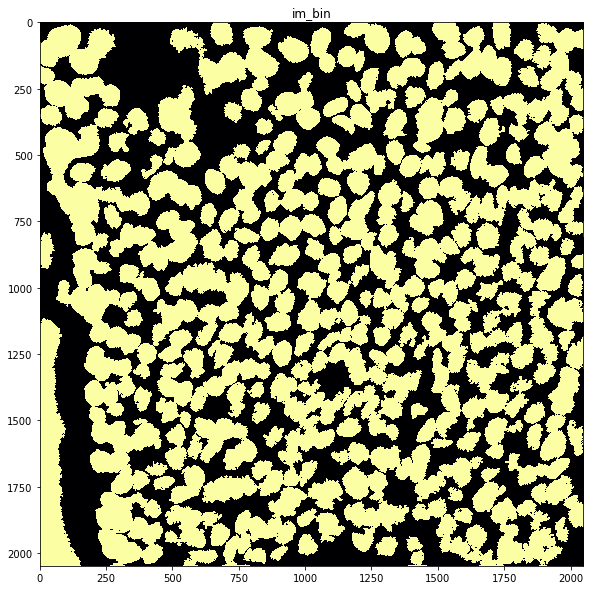

In [53]:
im_bin = binarize(wave_cell,50,1500)
fname = os.path.join(pos_path,'im_bin.tiff')
out = im_bin*1
out = out.astype(np.uint16)
tifffile.imsave(fname, np.swapaxes(out,0,2), metadata={'axes': 'ZYX'})
Display(im_bin[:,:,display_z],title='im_bin')

In [54]:
im_bin_save = im_bin

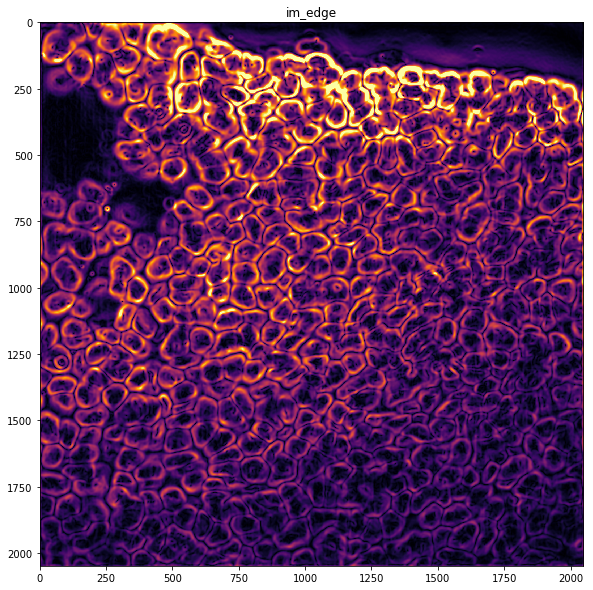

In [316]:
def sobel_edges(stk, val):
    temp = np.zeros_like(stk)
    if val != 0:
        if val <= 5:
            stk = filters.gaussian(stk, val)
        else:
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
            stk = filters.gaussian(stk, (val / 2))
    temp = np.zeros_like(stk)
    if len(stk.shape)==2:
        im = filters.sobel(stk) + 1
        temp = im
    elif len(stk.shape)==3:
        for z in range(stk.shape[2]):
            im = stk[:,:,z]
            im = filters.sobel(im) + 1
            temp[:,:,z]=im
    temp_min = np.percentile(temp.ravel(),0)
    temp[temp<temp_min] = temp_min
    temp = temp-temp_min
    temp_max = np.percentile(temp.ravel(),99.5)
    temp[temp>temp_max]=temp_max
    temp = temp/temp_max
    return temp
im_edge = sobel_edges(wave_cell, params['edge_filter_blur'])
fname = os.path.join(pos_path,'im_edge.tiff')
tifffile.imsave(fname, np.swapaxes(im_edge,0,2), metadata={'axes': 'ZYX'})
Display(im_edge[:,:,display_z],title='im_edge')

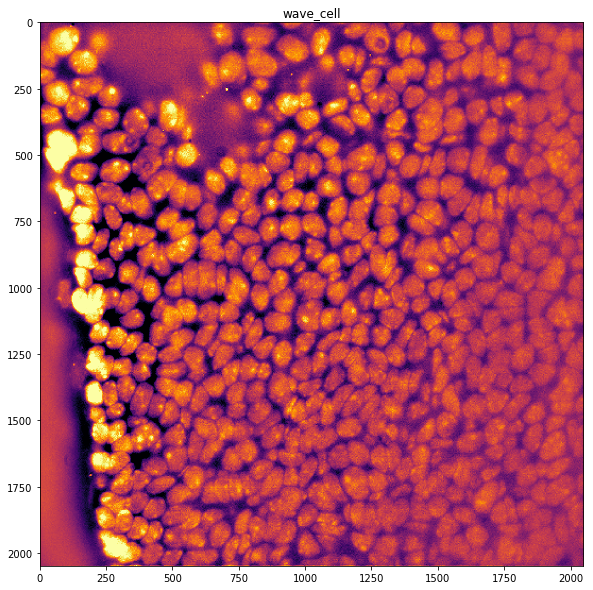

In [6]:
Display(wave_cell[:,:,display_z],title='wave_cell')

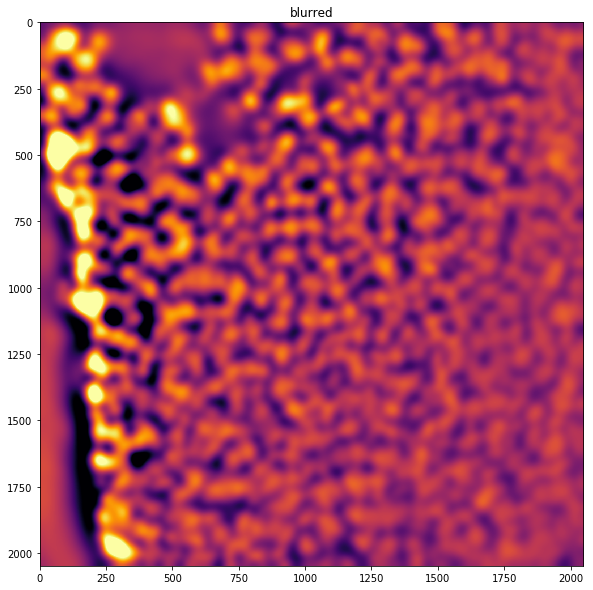

In [5]:
blurred = np.zeros_like(wave_cell)
for z in range(wave_cell.shape[2]):
    blurred[:,:,z] = filters.threshold_local(wave_cell[:,:,z],101)
fname = os.path.join(pos_path,'blurred.tiff')
tifffile.imsave(fname, np.swapaxes(blurred,0,2), metadata={'axes': 'ZYX'})
Display(blurred[:,:,display_z],title='blurred')

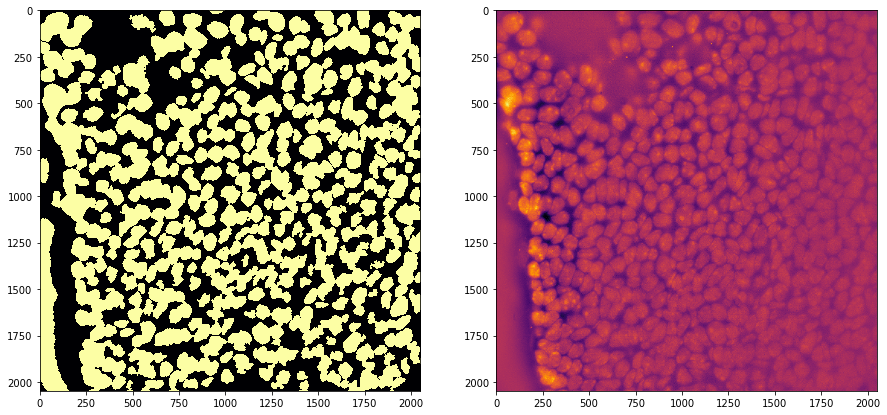

In [13]:
def binarize(stk,thresh,min_size):
    im_bin = np.zeros_like(stk)
    im_bin = im_bin!=0
    if stk.ndim==3:
        for z in range(stk.shape[2]):
            img = filters.gaussian(stk[:,:,z].copy(),1)
            binary = img>np.percentile(img.ravel(),thresh)
            binary = morphology.remove_small_objects(binary,50)
            binary = morphology.remove_small_holes(binary, min_size)
            binary = morphology.remove_small_objects(binary, min_size)
            dilated = morphology.binary_dilation(binary)
            for i in range(8):
                dilated = morphology.binary_erosion(dilated)
                dilated = morphology.binary_dilation(dilated)
            dilated = morphology.binary_dilation(dilated)
            im_bin[:,:,z] = dilated
    elif stk.ndim==2:
        img = filters.gaussian(stk.copy(),1)
        binary = img>np.percentile(img.ravel(),thresh)
        binary = morphology.remove_small_objects(binary,50)
        binary = morphology.remove_small_holes(binary, min_size)
        binary = morphology.remove_small_objects(binary, min_size)
        dilated = morphology.binary_dilation(binary)
        for i in range(8):
            dilated = morphology.binary_erosion(dilated)
            dilated = morphology.binary_dilation(dilated)
        dilated = morphology.binary_dilation(dilated)
        im_bin = dilated
    return im_bin
blurred_z = filters.threshold_local(wave_cell[:,:,display_z],21)
im_bin = binarize(blurred_z,50,1000)
%matplotlib inline
plt.figure(figsize=(15,15))
plt.subplot(1, 2, 1)
plt.imshow(im_bin,cmap='inferno')
plt.subplot(1, 2, 2)
plt.imshow(wave_cell[:,:,display_z],cmap='inferno')

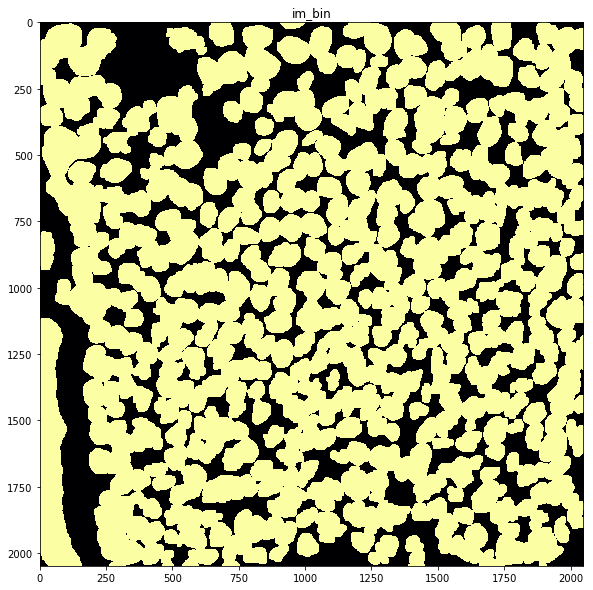

In [14]:
struct = ndimage.generate_binary_structure(2,2)
im_bin_temp = ndimage.binary_dilation(im_bin,structure=struct,iterations=5)
Display(im_bin_temp,title='im_bin')

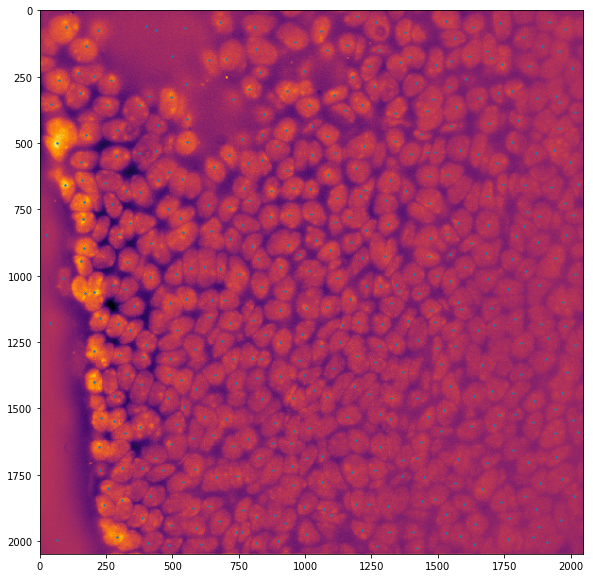

In [20]:
%matplotlib inline
plt.figure(figsize=(10,10))
blurred_z = filters.threshold_local(wave_cell[:,:,display_z],81)
xy = peak_local_max(blurred_z,min_distance=10)
plt.imshow(wave_cell[:,:,display_z],cmap='inferno')
plt.scatter(xy[:,1],xy[:,0],s=2)
plt.show()

/home/zach/PythonRepos/PyImages/segmentation_3D.py:324: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rgb_img[list(regions[i].coords.T)] = colors[i]  # won't use the 1st color


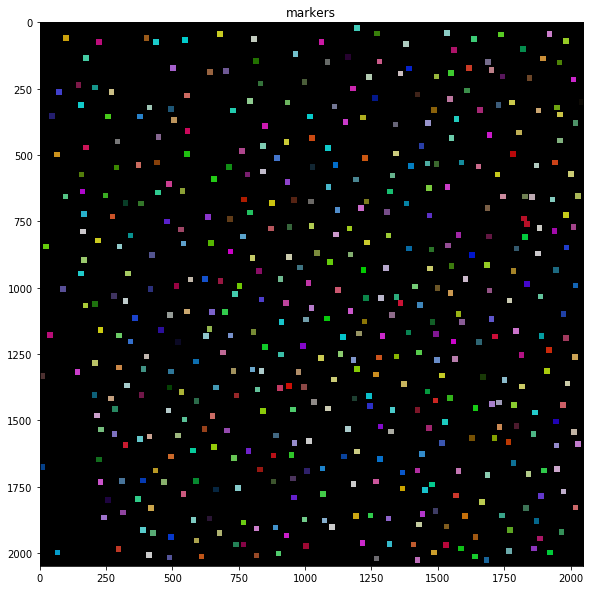

In [36]:
local_maxi = peak_local_max(blurred_z, indices=False, min_distance=int(5), exclude_border=int(1))
struct = ndimage.generate_binary_structure(2,2)
local_maxi = ndimage.binary_dilation(local_maxi,structure=struct,iterations=10)
structure = ndimage.morphology.generate_binary_structure(2,1)
markers = ndimage.label(local_maxi,structure=structure)[0]
markers[local_maxi] += 1
out = colorize_segmented_image(markers,color_type='rgb')
Display(out,title='markers',rel_min=0,rel_max=100)

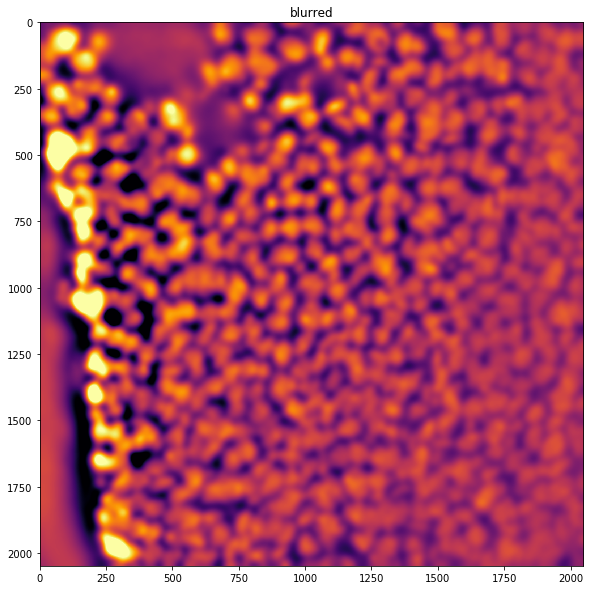

In [57]:
blurred_z = filters.threshold_local(wave_cell[:,:,display_z],75)
Display(blurred_z,title='blurred')

/home/zach/PythonRepos/PyImages/segmentation_3D.py:324: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rgb_img[list(regions[i].coords.T)] = colors[i]  # won't use the 1st color


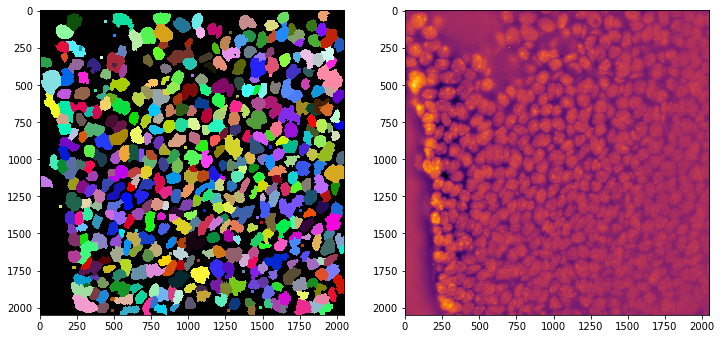

In [56]:
val = 0.8
struct = ndimage.generate_binary_structure(2,2)
im_bin_temp = ndimage.binary_dilation(im_bin_save[:,:,display_z],structure=struct,iterations=5)
markers_temp = markers + np.logical_not(im_bin_temp)
shed_im = (1 - val) * im_edge[:,:,display_z] - val * d_mat[:,:,display_z]
labels = morphology.watershed(image=shed_im, markers=markers_temp)
labels -= 1
edges = 1
if edges == 1:
    edge_vec = np.hstack((labels[:, 0].flatten(), labels[:, -1].flatten(), labels[0, :].flatten(),labels[-1, :].flatten()))
    edge_val = np.unique(edge_vec)
    for val in edge_val:
        if not val == 0:
            labels[labels == val] = 0

plt.figure(figsize=(12,12))
plt.subplot(1, 2, 1)
out = colorize_segmented_image(labels,color_type='rgb')
plt.imshow(out)
# Display(out,title='labels',rel_min=0,rel_max=100,figsize=(5,5))
plt.subplot(1, 2, 2)
plt.imshow(wave_cell[:,:,display_z],cmap='inferno')
# Display(wave_cell[:,:,display_z],title='labels',rel_min=0,rel_max=100,figsize=(5,5))

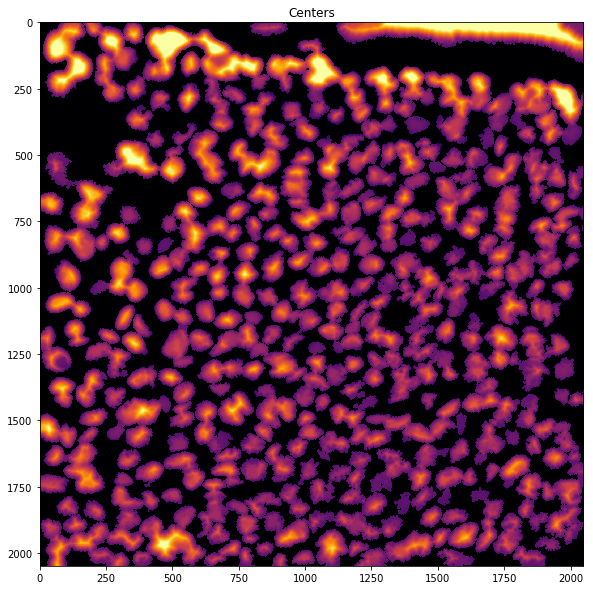

In [317]:
[cell_center, d_mat] = cell_centers(blurred, im_bin, params['dist_intensity_ratio'])
fname = os.path.join(pos_path,'cell_centers.tiff')
tifffile.imsave(fname, np.swapaxes(cell_center,0,2), metadata={'axes': 'ZYX'})
fname = os.path.join(pos_path,'d_mat.tiff')
tifffile.imsave(fname, np.swapaxes(d_mat,0,2), metadata={'axes': 'ZYX'})
Display(cell_center[:,:,display_z],title='Centers')

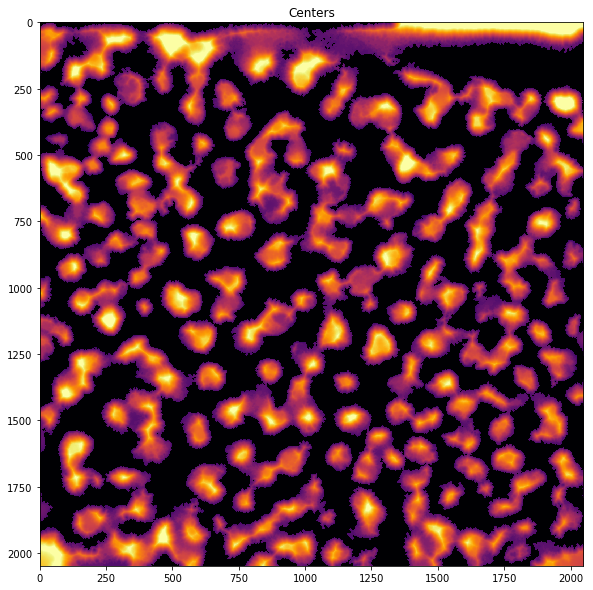

In [461]:
Display(cell_center[:,:,65],title='Centers')

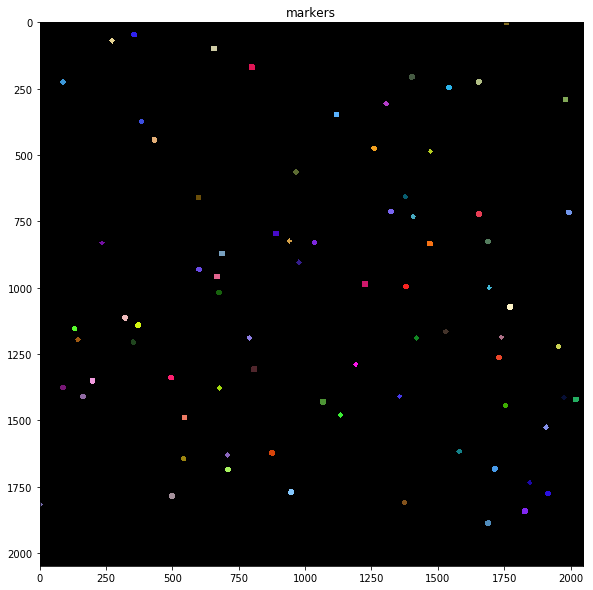

In [417]:
markers = fg_markers(cell_center, im_bin, 20, params['remove_image_edges'])
fname = os.path.join(pos_path,'markers.tiff')
tifffile.imsave(fname, np.swapaxes(markers,0,2), metadata={'axes': 'ZYX'})
out = colorize_segmented_image(markers[:,:,display_z])
Display(out,title='markers',rel_min=0,rel_max=100)

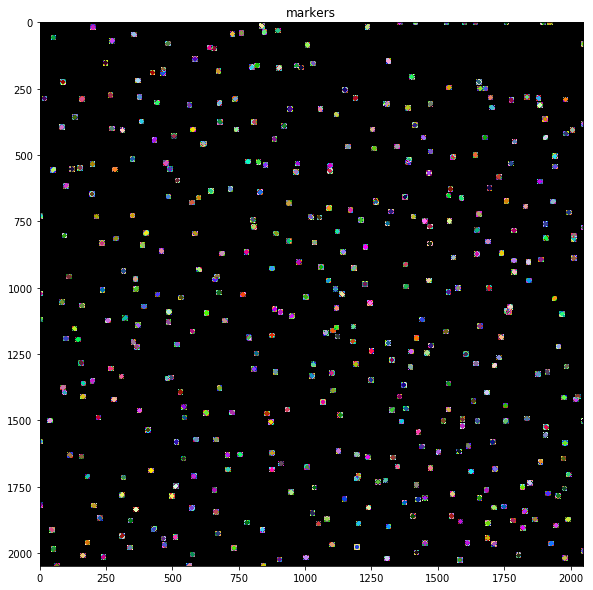

In [418]:
out = colorize_segmented_image(np.sum(markers,axis=2))
Display(out,title='markers',rel_min=0,rel_max=100)

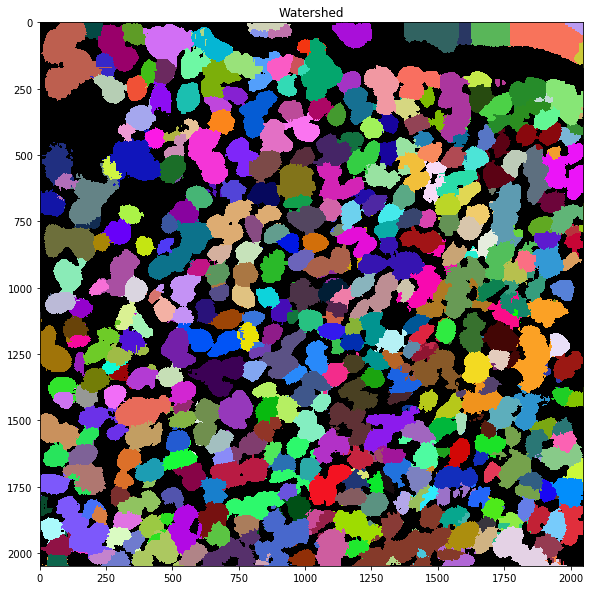

In [420]:
watershed = watershed(markers, im_bin, im_edge, d_mat, params['watershed_ratio'], params['remove_image_edges'])
fname = os.path.join(pos_path,'watershed.tiff')
tifffile.imsave(fname, np.swapaxes(watershed,0,2), metadata={'axes': 'ZYX'})
out = colorize_segmented_image(watershed[:,:,display_z])
Display(out,title='Watershed')

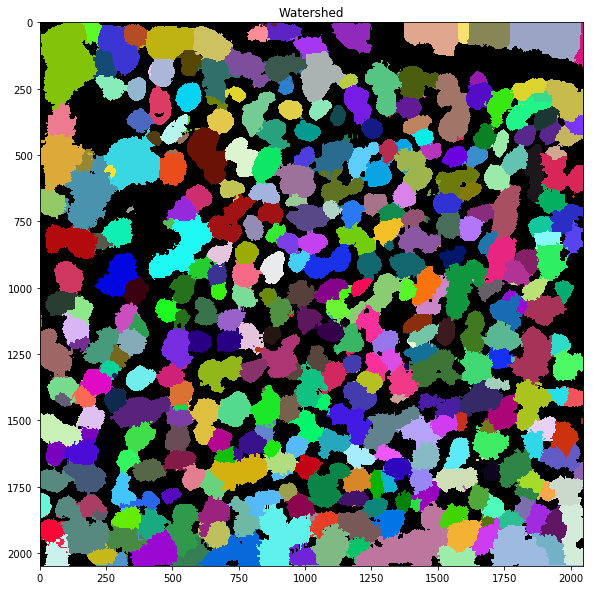

In [421]:
out = colorize_segmented_image(watershed[:,:,10])
Display(out,title='Watershed')

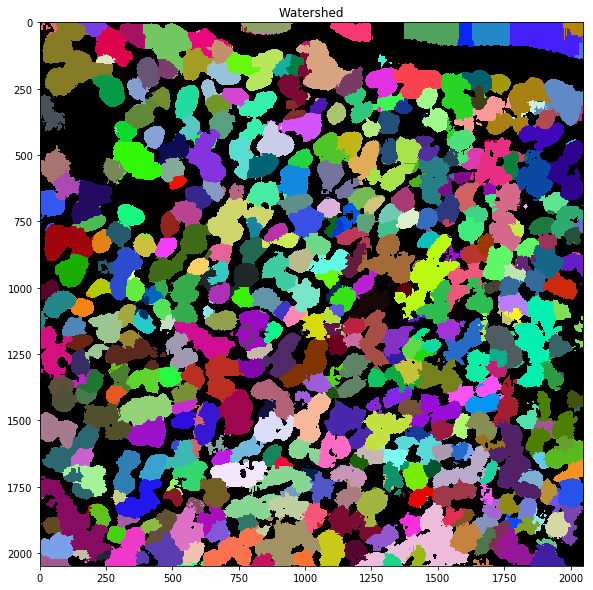

In [422]:
out = colorize_segmented_image(watershed[:,:,30])
Display(out,title='Watershed')

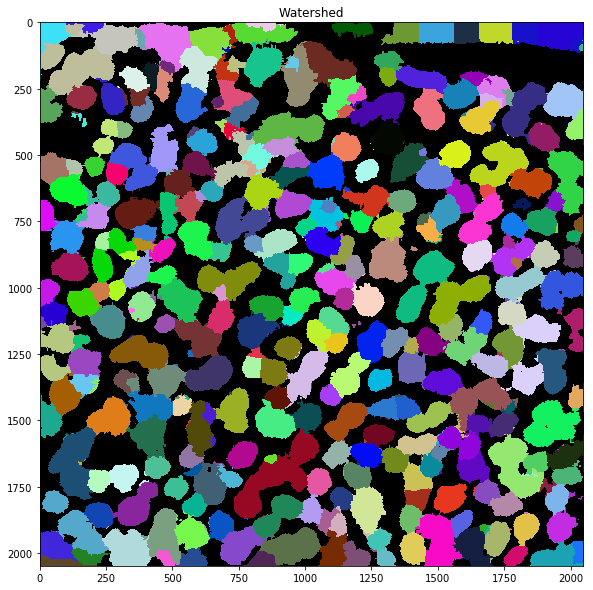

In [423]:
out = colorize_segmented_image(watershed[:,:,50])
Display(out,title='Watershed')

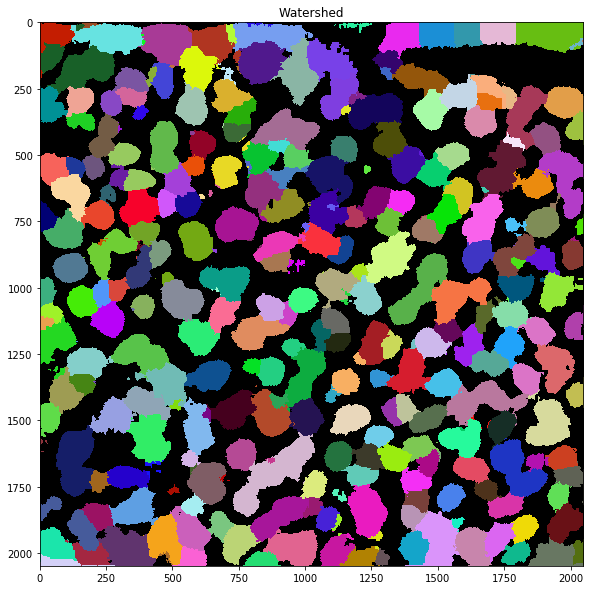

In [424]:
out = colorize_segmented_image(watershed[:,:,60])
Display(out,title='Watershed')

In [458]:
keep_watershed = watershed.copy()
regions = regionprops(watershed,intensity_image=wave_cell)
area = []
mean_intensity = []
keepers = []
tossers = []
for region in regions:
    area.append(region.area)
    mean_intensity.append(region.mean_intensity)
    if region.area>10**5.75 or region.area<10**5:
        tossers.append(region.label)
        keep_watershed[keep_watershed==region.label]=0
    elif region.mean_intensity>10**-0.15 or region.mean_intensity<10**-0.32:
        tossers.append(region.label)
        keep_watershed[keep_watershed==region.label]=0
    else:
        keepers.append(region.label)
fname = os.path.join(pos_path,'keep_watershed.tiff')
tifffile.imsave(fname, np.swapaxes(keep_watershed,0,2), metadata={'axes': 'ZYX'})

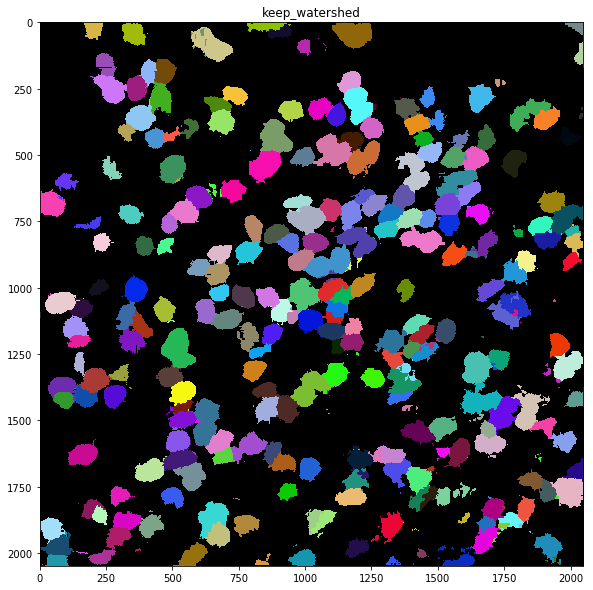

In [459]:
out = colorize_segmented_image(keep_watershed[:,:,20])
Display(out,title='keep_watershed')

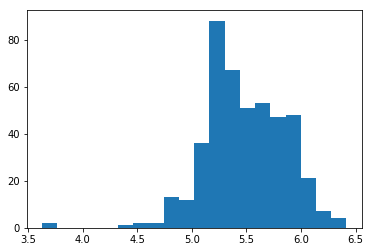

In [443]:
plt.hist(np.log10(area),bins=20)
plt.show()

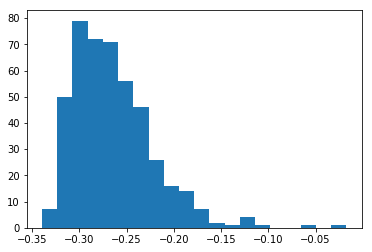

In [442]:
plt.hist(np.log10(mean_intensity),bins=20)
plt.show()

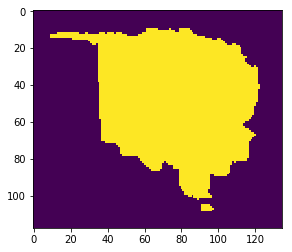

In [434]:
plt.imshow(regions[15].image[:,:,5])

In [26]:
import plotly 
import plotly.graph_objs as go
plotly.offline.init_notebook_mode(connected=True)
X = coordinates[:,0]
Y = coordinates[:,1]
Z = coordinates[:,2]
plotly.offline.iplot({"data": [go.Scatter3d(x=X, y=Y, z=Z, mode='markers')]})